In [1]:
import os
import numpy as np
import torch
import matplotlib.pyplot as plt
from PIL import Image
from utils import show_masks,show_points,show_box,show_mask,show_mask_v,get_bounding_box


In [2]:
# 检测GPU
if torch.cuda.is_available():
    device = torch.device("cuda")
elif torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print(f"using device: {device}")
#使用bfloat16精度
#如果是Ampere架构（版本号>8）则启用tensorfloat-32精度，提升矩阵乘法和卷积运算的性能
if device.type == "cuda":
    # use bfloat16 for the entire notebook
    torch.autocast("cuda", dtype=torch.bfloat16).__enter__()
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    if torch.cuda.get_device_properties(0).major >= 8:
        torch.backends.cuda.matmul.allow_tf32 = True
        torch.backends.cudnn.allow_tf32 = True

using device: cuda


In [3]:
np.random.seed(3) #每次都是相同随机数序列，结果可重复

In [4]:
###main###
# image = Image.open('D:/GithubDesktopClone/UIST/m_data/raw_img/0-custom/0000.jpg')
image = Image.open('D:/GithubDesktopClone/UIST/m_data/test.jpg')
image = np.array(image.convert("RGB"))
# 如果需要再转换回 Pillow 图像对象
image_array = np.array(image)
image = Image.fromarray(image_array)

# 保存图像
image.save('D:/GithubDesktopClone/UIST/m_data/raw_img/processed_image.jpg', 'JPEG')

In [5]:
##setup predictor##这个部分好像很慢
from sam2.build_sam import build_sam2
from sam2.sam2_image_predictor import SAM2ImagePredictor
sam2_checkpoint="../../sam2/checkpoints/sam2.1_hiera_large.pt"

model_cfg="configs/sam2.1/sam2.1_hiera_l.yaml"#为什么不报错呢
sam2_model=build_sam2(model_cfg,sam2_checkpoint,device=device)
predictor=SAM2ImagePredictor(sam2_model)

In [6]:
predictor.set_image(image)

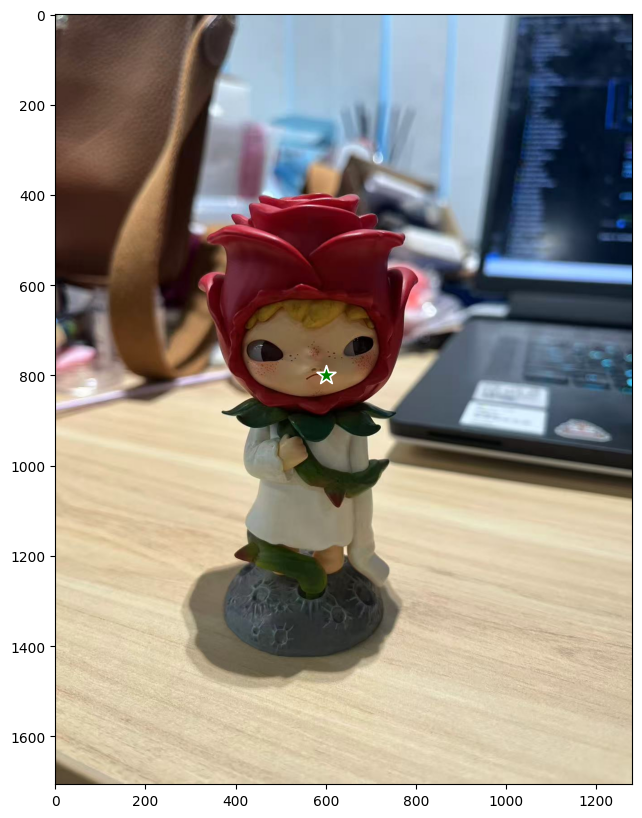

In [8]:
#可视化选择的物品的地点
input_point = np.array([[600, 800]])
input_label = np.array([1])
plt.figure(figsize=(10, 10))
plt.imshow(image)
show_points(input_point, input_label, plt.gca())
plt.axis('on')
plt.show()  

(3, 1707, 1280)


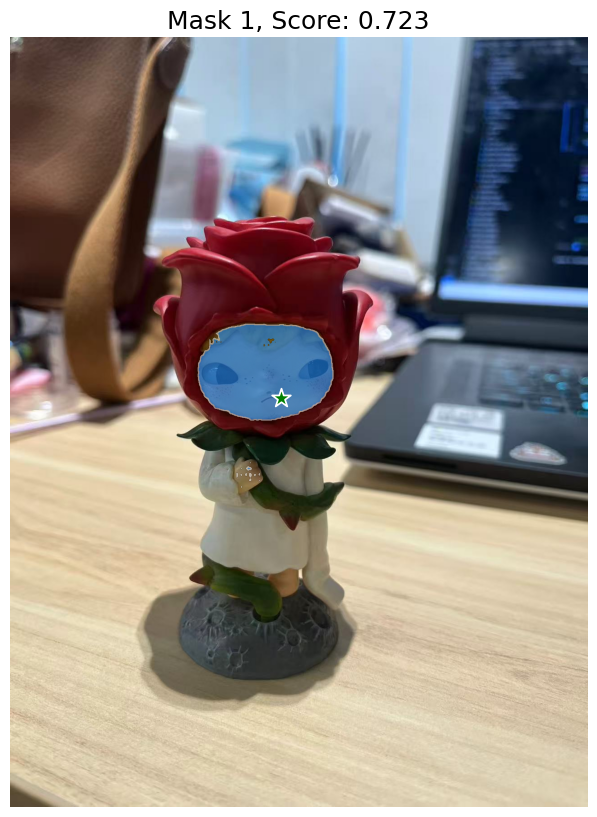

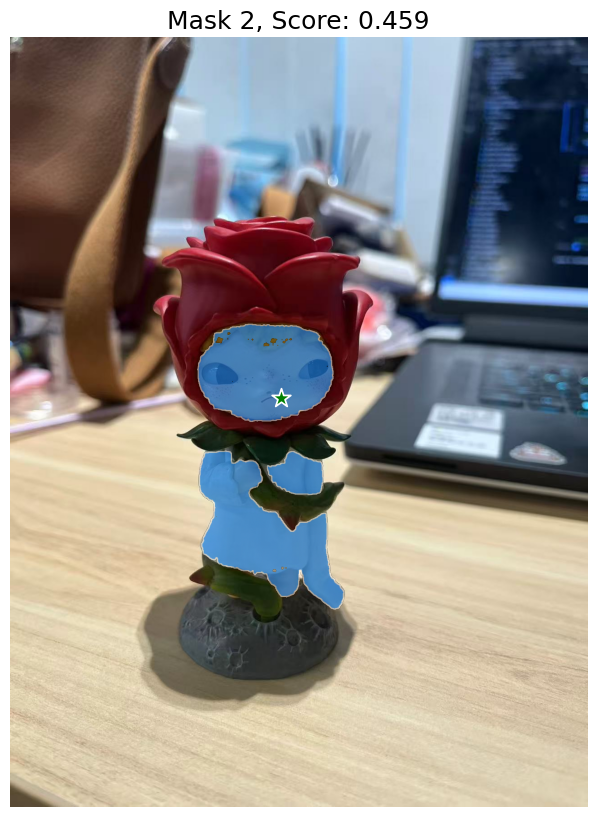

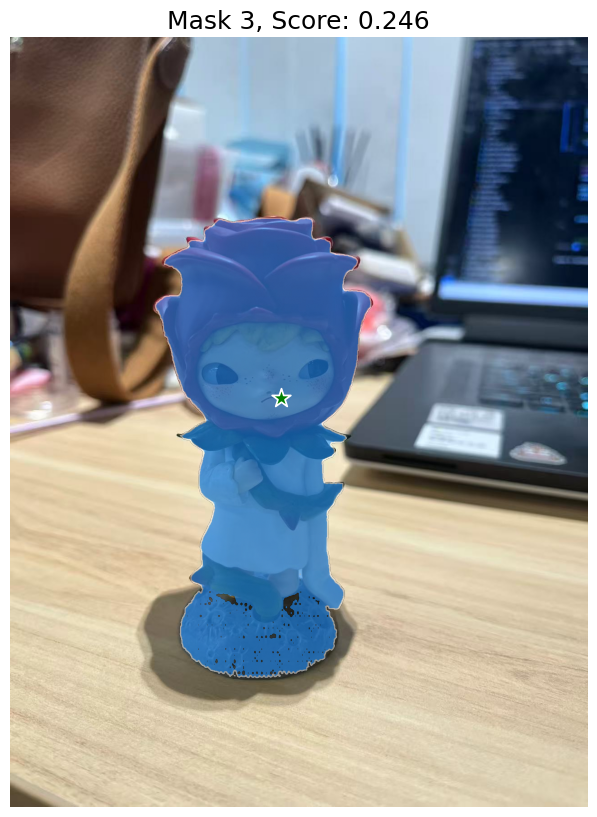

In [9]:
masks,scores,logits=predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
)
sorted_ind=np.argsort(scores)[::-1]
masks=masks[sorted_ind]
scores=scores[sorted_ind]
logits=logits[sorted_ind]

print(masks.shape)
show_masks(image, masks, scores, point_coords=input_point, input_labels=input_label, borders=True)

In [117]:
#多个附加点指定单个对象
input_point = np.array([[150, 100], [150, 240]])
input_label = np.array([1, 1])
mask_input=logits[np.argmax(scores), :, :]
masks,scores,_=predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    mask_input=mask_input[None,:,:],
    multimask_output=False,#请求单个掩码
)

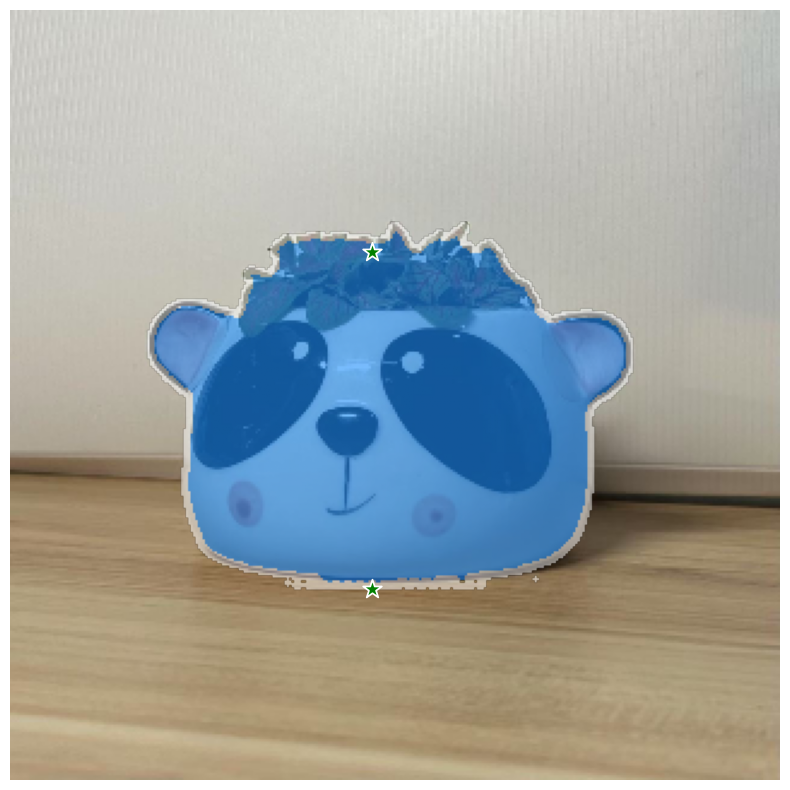

In [118]:
show_masks(image, masks, scores, point_coords=input_point, input_labels=input_label)

In [107]:
#使用框选指定
input_box = np.array([425, 700, 700, 950])

In [110]:
masks, scores, _ = predictor.predict(
    point_coords=None,
    point_labels=None,
    box=input_box[None, :],
    multimask_output=False,
)

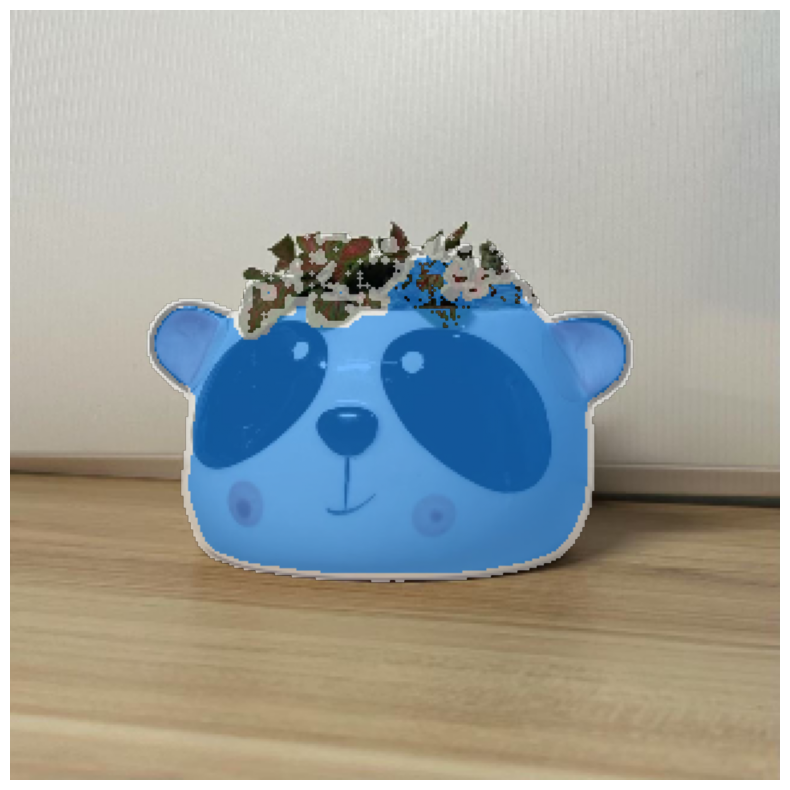

In [111]:
show_masks(image, masks, scores, box_coords=input_box)

In [ ]:
print(masks[0].shape[-2:])
contours, hierarchy = cv2.findContours(masks[0], cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
#  contours, _ = cv2.findContours(mask,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
for contour in contours:
    # 获取外接矩形
    x, y, w, h = cv2.boundingRect(contour)
    input_box = np.array([x, y, x+w, y+h])
# input_box = np.array([425, 700, 700, 1200])

(1707, 1280)


# video predictor

In [6]:
from sam2.build_sam import build_sam2_video_predictor
predictor2=build_sam2_video_predictor(model_cfg, sam2_checkpoint, device=0)

In [23]:
class_name='7-lipstick'

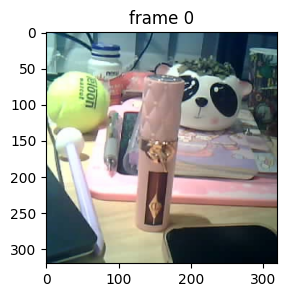

In [24]:
# video_dir='../../m_data/YE/raw_img'
video_dir = os.path.join('../../m_data', 'raw_img',class_name)
# scan all the JPEG frame names in this directory
frame_names = [
    p for p in os.listdir(video_dir)
    if os.path.splitext(p)[-1] in [".jpg", ".jpeg", ".JPG", ".JPEG",".png"]
]
frame_names.sort(key=lambda p: int(os.path.splitext(p)[0]))
# take a look the first video frame
frame_idx = 0
plt.figure(figsize=(4, 3))
plt.title(f"frame {frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[frame_idx])))



In [25]:
inference_state = predictor2.init_state(video_path=video_dir)

frame loading (JPEG): 100%|██████████| 100/100 [00:03<00:00, 31.51it/s]


In [26]:
points = np.array([[160, 100],[160, 200]], dtype=np.float32)
# box = np.array([30, 0, 300, 300], dtype=np.float32)

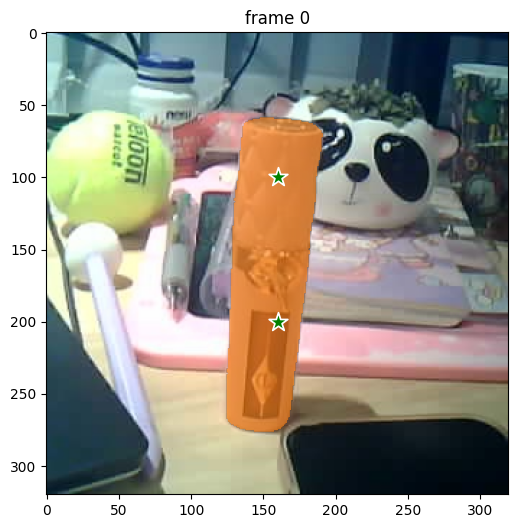

In [27]:
ann_frame_idx = 0  # the frame index we interact with
ann_obj_id = 1  # give a unique id to each object we interact with (it can be any integers)

# Let's add a positive click at (x, y) = (210, 350) to get started
# for labels, `1` means positive click and `0` means negative click
labels = np.array([1,1], np.int32)
_, out_obj_ids, out_mask_logits = predictor2.add_new_points_or_box(
    inference_state=inference_state,
    frame_idx=ann_frame_idx,
    obj_id=ann_obj_id,
    points=points,
    labels=labels,
    # box=box,
)

# show the results on the current (interacted) frame
plt.figure(figsize=(6, 6))
plt.title(f"frame {ann_frame_idx}")
plt.imshow(Image.open(os.path.join(video_dir, frame_names[ann_frame_idx])))
show_points(points, labels, plt.gca())
# show_box(box, plt.gca())
show_mask_v((out_mask_logits[0] > 0.0).cpu().numpy(), plt.gca(), obj_id=out_obj_ids[0])

propagate in video: 100%|██████████| 100/100 [00:17<00:00,  5.85it/s]


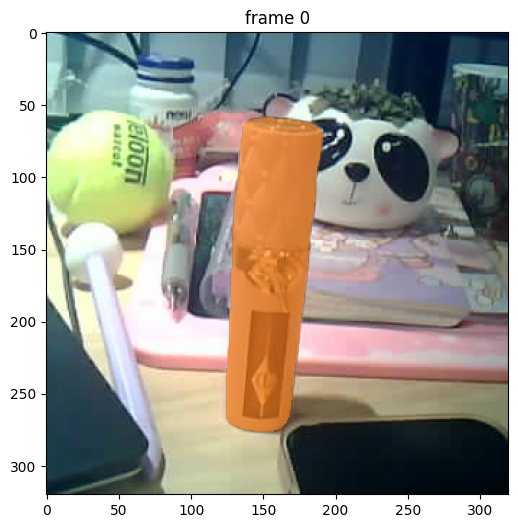

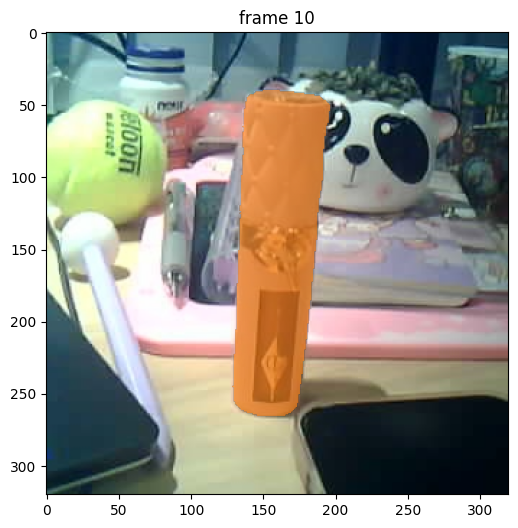

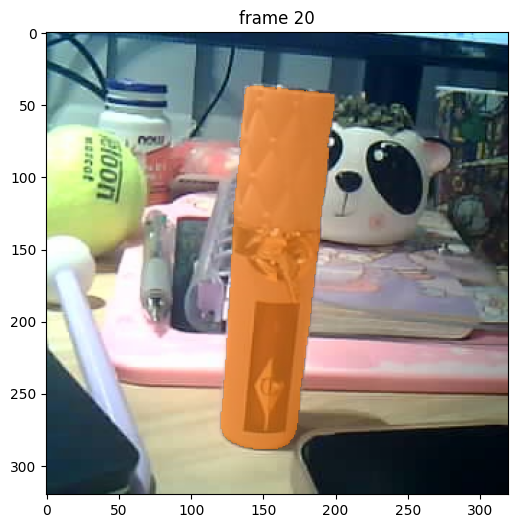

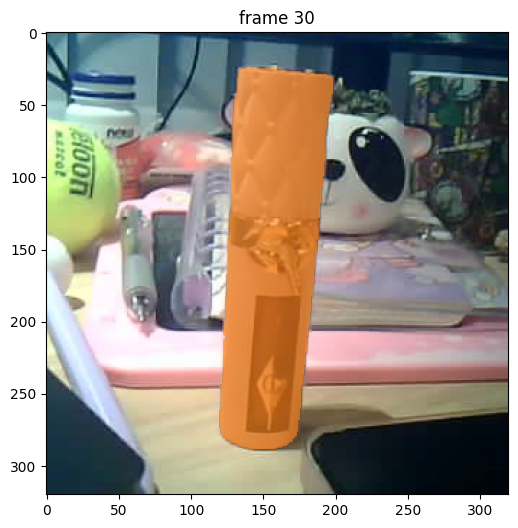

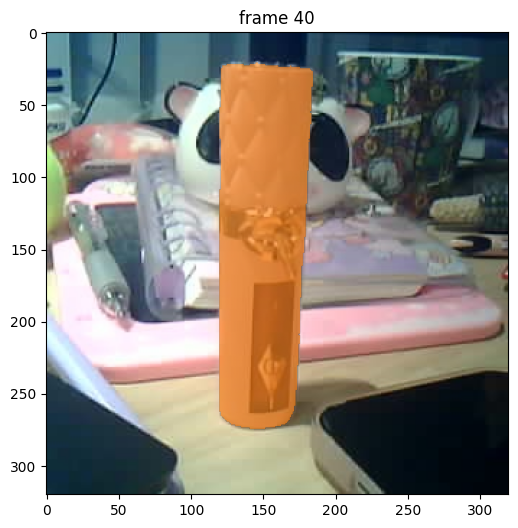

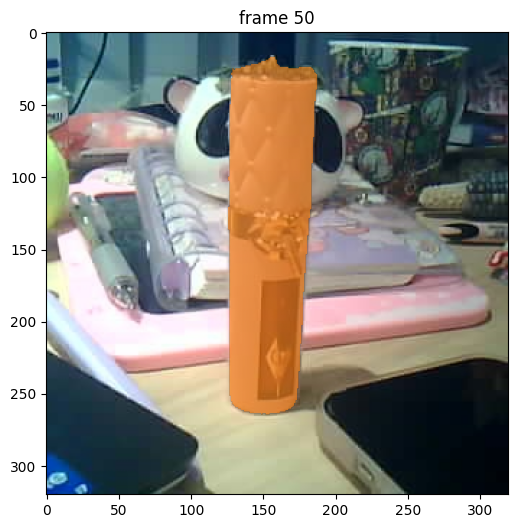

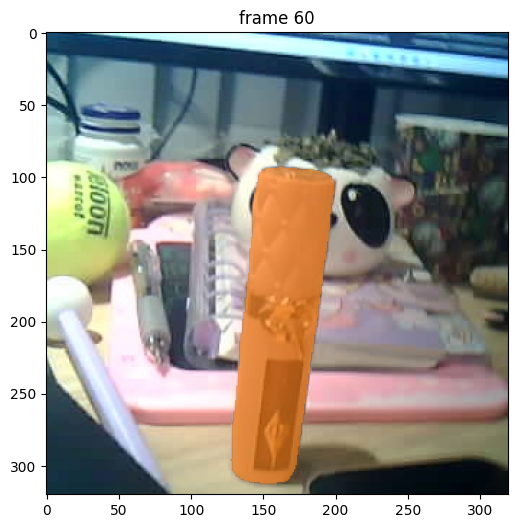

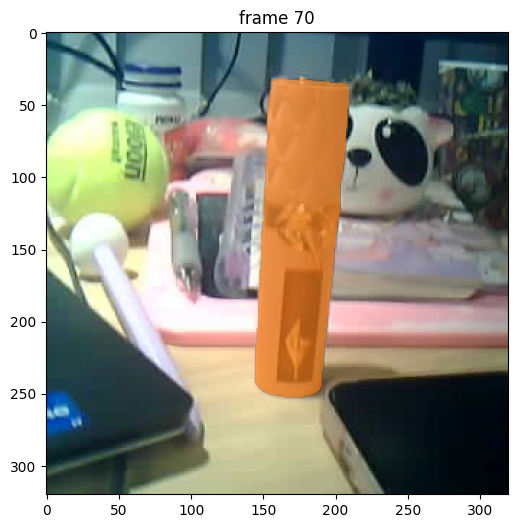

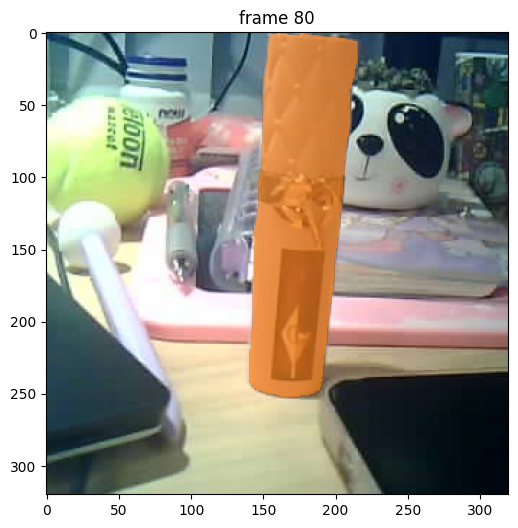

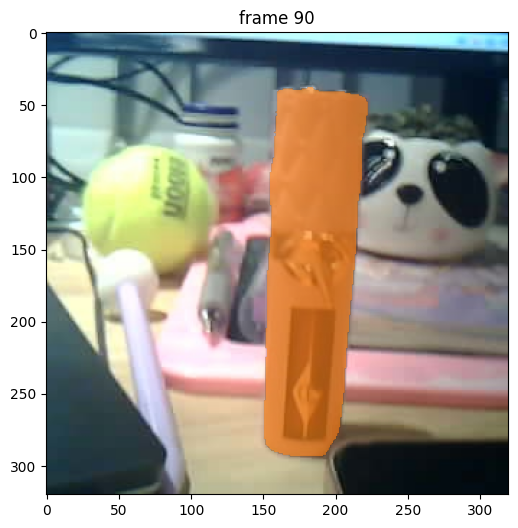

In [28]:
# run propagation throughout the video and collect the results in a dict
video_segments = {}  # video_segments contains the per-frame segmentation results
for out_frame_idx, out_obj_ids, out_mask_logits in predictor2.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }

# render the segmentation results every few frames
vis_frame_stride = 10
plt.close("all")
for out_frame_idx in range(0, len(frame_names), vis_frame_stride):
    plt.figure(figsize=(6, 6))
    plt.title(f"frame {out_frame_idx}")
    plt.imshow(Image.open(os.path.join(video_dir, frame_names[out_frame_idx])))
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        show_mask_v(out_mask, plt.gca(), obj_id=out_obj_id)

In [13]:
#从SAM结果创建YOLO训练数据集
video_segments = {}  # video_segments contains the per-frame segmentation results
for out_frame_idx, out_obj_ids, out_mask_logits in predictor2.propagate_in_video(inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
    }


propagate in video: 100%|██████████| 100/100 [00:17<00:00,  5.87it/s]


In [14]:
#这个地方应该是要处理这个data.yaml
import yaml
yaml_file_path='../../m_data/data.yaml'
if not os.path.exists(yaml_file_path):
    data = {
        # 添加训练、验证和测试文件夹
        'train':'../../m_data/train',
        'val':'../../m_data/valid',
        'test':'../../m_data/test',
        'nc':0,
        'names': []
        }
    with open('../../m_data/data.yaml', 'w') as file:
        yaml.dump(data, file)

with open(yaml_file_path, 'r') as file:
    data = yaml.safe_load(file)
    # 添加类别数量和名称
    items = os.listdir('../../m_data/raw_img')
    data['nc'] = sum(1 for item in items if os.path.isdir(os.path.join('../../m_data/raw_img', item)))

    data['names']=[item for item in os.listdir('../../m_data/raw_img') if os.path.isdir(os.path.join('../../m_data/raw_img', item))][::-1]

# 写回 data.yaml 文件
with open('../../m_data/data.yaml', 'w') as file:
    yaml.dump(data, file)

print("data.yaml 文件已更新。")

data.yaml 文件已更新。


yolo:data: 0.621875 0.528125 0.7375 0.9375
yolo:data: 0.625 0.5265625 0.74375 0.940625
yolo:data: 0.6265625 0.5234375 0.740625 0.946875
yolo:data: 0.6296875 0.5234375 0.734375 0.946875
yolo:data: 0.6234375 0.51875 0.740625 0.95625
yolo:data: 0.625 0.5171875 0.74375 0.959375
yolo:data: 0.6234375 0.5171875 0.740625 0.959375
yolo:data: 0.6109375 0.5171875 0.740625 0.959375
yolo:data: 0.60625 0.5171875 0.7375 0.959375
yolo:data: 0.5984375 0.5140625 0.740625 0.965625
yolo:data: 0.5984375 0.5125 0.740625 0.96875
yolo:data: 0.6015625 0.5046875 0.740625 0.984375
yolo:data: 0.61875 0.4984375 0.75625 0.996875
yolo:data: 0.625 0.4984375 0.74375 0.996875
yolo:data: 0.6265625 0.4984375 0.740625 0.996875
yolo:data: 0.625 0.4984375 0.74375 0.996875
yolo:data: 0.6203125 0.4984375 0.753125 0.996875
yolo:data: 0.6125 0.4984375 0.76875 0.996875
yolo:data: 0.6078125 0.4984375 0.778125 0.996875
yolo:data: 0.5984375 0.4984375 0.778125 0.996875
yolo:data: 0.590625 0.4984375 0.7875 0.996875
yolo:data: 0.59531

C:\Users\18054\AppData\Local\Temp\ipykernel_12128\2327239058.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(6, 4))


yolo:data: 0.5984375 0.4984375 0.796875 0.996875
yolo:data: 0.5984375 0.4984375 0.796875 0.996875
yolo:data: 0.5984375 0.4984375 0.796875 0.996875
yolo:data: 0.6046875 0.4984375 0.784375 0.996875
yolo:data: 0.6046875 0.4984375 0.784375 0.996875
yolo:data: 0.5953125 0.5109375 0.803125 0.971875
yolo:data: 0.584375 0.53125 0.825 0.93125
yolo:data: 0.5703125 0.5375 0.853125 0.91875
yolo:data: 0.575 0.525 0.84375 0.94375
yolo:data: 0.5828125 0.534375 0.828125 0.925
yolo:data: 0.5953125 0.5421875 0.803125 0.909375
yolo:data: 0.6046875 0.528125 0.784375 0.93125
yolo:data: 0.6015625 0.446875 0.790625 0.89375
yolo:data: 0.5734375 0.4421875 0.790625 0.884375
yolo:data: 0.56875 0.4546875 0.7875 0.909375
yolo:data: 0.596875 0.484375 0.775 0.925
yolo:data: 0.615625 0.5046875 0.7625 0.903125
yolo:data: 0.6203125 0.5046875 0.753125 0.903125
yolo:data: 0.63125 0.521875 0.73125 0.8875
yolo:data: 0.65 0.525 0.69375 0.8875
yolo:data: 0.6546875 0.5296875 0.684375 0.884375
yolo:data: 0.653125 0.5375 0.6875

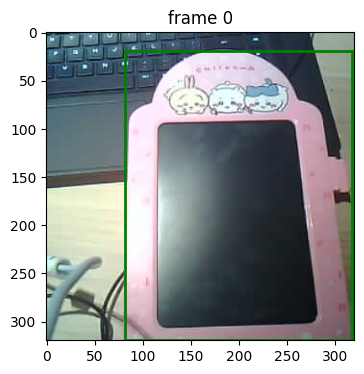

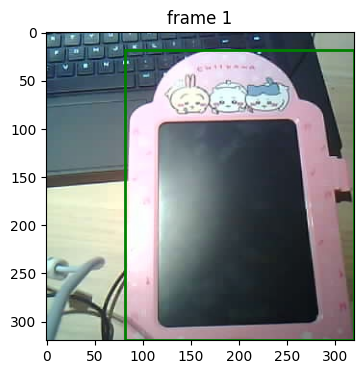

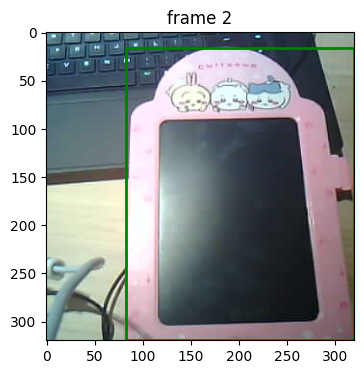

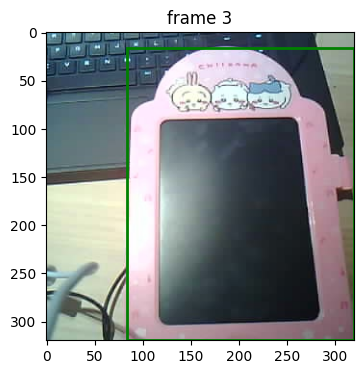

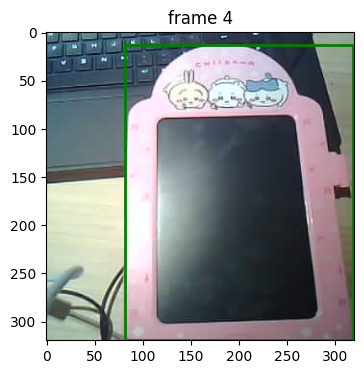

...

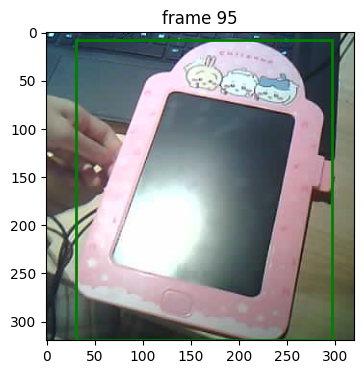

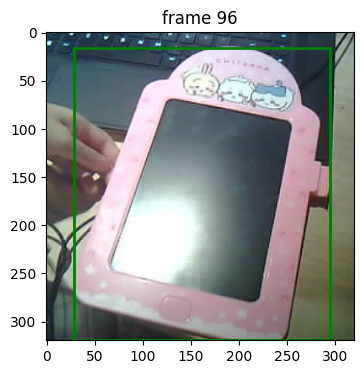

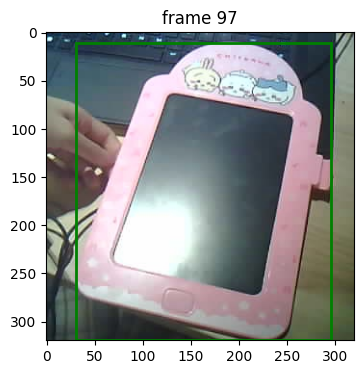

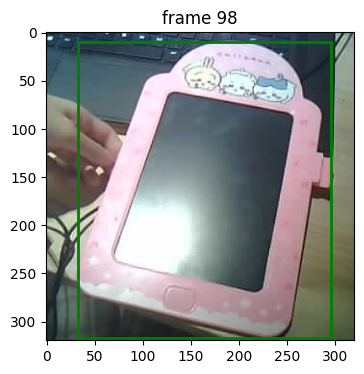

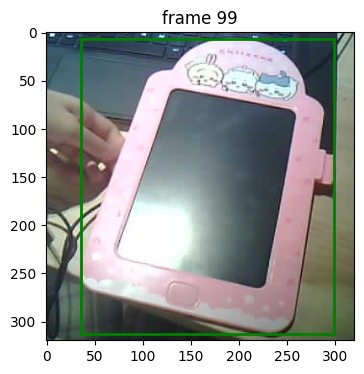

In [15]:
# 获取文件夹中的所有项
items = os.listdir('../../m_data/raw_img')
# 统计子文件夹的数量
subfolder_count = sum(1 for item in items if os.path.isdir(os.path.join('../../m_data/raw_img', item)))
class_id=subfolder_count-1

# render the segmentation results every few frames
vis_frame_stride = 3
plt.close("all")
#train
for out_frame_idx in range(0, int(7*len(frame_names)/10), 1):
    stat='train'
    YOYO_img_dir = os.path.join('../../m_data',stat, 'images')
    YOYO_lab_dir = os.path.join('../../m_data',stat, 'labels')
    os.makedirs(YOYO_img_dir, exist_ok=True)
    os.makedirs(YOYO_lab_dir, exist_ok=True)  
    image=Image.open(os.path.join(video_dir, frame_names[out_frame_idx]))
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    plt.imshow(image)
    output_image_path = os.path.join(YOYO_img_dir, str(class_name)+'_'+frame_names[out_frame_idx])
    image.save(output_image_path)
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        # print(out_mask.shape)
        x0,y0,x1,y1=get_bounding_box(out_mask[0])
        # show_mask_v(out_mask, plt.gca(), obj_id=out_obj_id)#叠加binary图像
        print("yolo:data:" ,(x0+x1)/2/out_mask.shape[1], (y0+y1)/2/out_mask.shape[2],(x1-x0)/out_mask.shape[1],(y1-y0)/out_mask.shape[2])
        values=[class_id,(x0+x1)/2/out_mask.shape[1], (y0+y1)/2/out_mask.shape[2],(x1-x0)/out_mask.shape[1],(y1-y0)/out_mask.shape[2]]
        formatted_values = ' '.join(str(value) for value in values)
        output_txt_path = os.path.join(YOYO_lab_dir, str(class_name)+'_'+frame_names[out_frame_idx].rstrip('.jpg')+'.txt')
        with open(output_txt_path, 'w') as f:
            f.write(formatted_values)
        plt.gca().add_patch(plt.Rectangle((x0, y0), x1-x0, y1-y0, edgecolor='green', facecolor=(0, 0, 0, 0),lw=2))
        #创建一个txt文件存储
for out_frame_idx in range(int(7*len(frame_names)/10), int(9*len(frame_names)/10), 1):
    stat='valid'
    YOYO_img_dir = os.path.join('../../m_data',stat, 'images')
    YOYO_lab_dir = os.path.join('../../m_data',stat, 'labels')
    os.makedirs(YOYO_img_dir, exist_ok=True)
    os.makedirs(YOYO_lab_dir, exist_ok=True)  
    image=Image.open(os.path.join(video_dir, frame_names[out_frame_idx]))
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    plt.imshow(image)
    output_image_path = os.path.join(YOYO_img_dir, str(class_name)+'_'+frame_names[out_frame_idx])
    image.save(output_image_path)
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        # print(out_mask.shape)
        x0,y0,x1,y1=get_bounding_box(out_mask[0])
        # show_mask_v(out_mask, plt.gca(), obj_id=out_obj_id)#叠加binary图像
        print("yolo:data:" ,(x0+x1)/2/out_mask.shape[1], (y0+y1)/2/out_mask.shape[2],(x1-x0)/out_mask.shape[1],(y1-y0)/out_mask.shape[2])
        values=[class_id,(x0+x1)/2/out_mask.shape[1], (y0+y1)/2/out_mask.shape[2],(x1-x0)/out_mask.shape[1],(y1-y0)/out_mask.shape[2]]
        formatted_values = ' '.join(str(value) for value in values)
        output_txt_path = os.path.join(YOYO_lab_dir, str(class_name)+'_'+frame_names[out_frame_idx].rstrip('.jpg')+'.txt')
        with open(output_txt_path, 'w') as f:
            f.write(formatted_values)
        plt.gca().add_patch(plt.Rectangle((x0, y0), x1-x0, y1-y0, edgecolor='green', facecolor=(0, 0, 0, 0),lw=2))
for out_frame_idx in range(int(9*len(frame_names)/10), len(frame_names), 1):
    stat='test'
    YOYO_img_dir = os.path.join('../../m_data',stat, 'images')
    YOYO_lab_dir = os.path.join('../../m_data',stat, 'labels')
    os.makedirs(YOYO_img_dir, exist_ok=True)
    os.makedirs(YOYO_lab_dir, exist_ok=True)  
    image=Image.open(os.path.join(video_dir, frame_names[out_frame_idx]))
    plt.figure(figsize=(6, 4))
    plt.title(f"frame {out_frame_idx}")
    plt.imshow(image)
    output_image_path = os.path.join(YOYO_img_dir, str(class_name)+'_'+frame_names[out_frame_idx])
    image.save(output_image_path)
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
        # print(out_mask.shape)
        x0,y0,x1,y1=get_bounding_box(out_mask[0])
        # show_mask_v(out_mask, plt.gca(), obj_id=out_obj_id)#叠加binary图像
        # print("yolo:data:" ,(x0+x1)/2/out_mask.shape[1], (y0+y1)/2/out_mask.shape[2],(x1-x0)/out_mask.shape[1],(y1-y0)/out_mask.shape[2])
        values=[class_id,(x0+x1)/2/out_mask.shape[1], (y0+y1)/2/out_mask.shape[2],(x1-x0)/out_mask.shape[1],(y1-y0)/out_mask.shape[2]]
        formatted_values = ' '.join(str(value) for value in values)
        output_txt_path = os.path.join(YOYO_lab_dir, str(class_name)+'_'+frame_names[out_frame_idx].rstrip('.jpg')+'.txt')
        with open(output_txt_path, 'w') as f:
            f.write(formatted_values)
        plt.gca().add_patch(plt.Rectangle((x0, y0), x1-x0, y1-y0, edgecolor='green', facecolor=(0, 0, 0, 0),lw=2))
#创建一个dataset路径，training，images，lables